In [1]:
import warnings
warnings.filterwarnings('ignore')
import torchvision
from torchvision import models
import torch
import torch.nn as nn
import numpy as np
import cv2
import glob
import requests
from pytorch_grad_cam import GradCAM
from pytorch_grad_cam.utils.model_targets import ClassifierOutputTarget
from pytorch_grad_cam.utils.image import show_cam_on_image, \
    deprocess_image, \
    preprocess_image
from PIL import Image
import matplotlib.pyplot as plt
import albumentations as A

# Load model

In [2]:
weights = 'logs/models/desktop-denayer_August16_12_03_45_mobilenetv2_wheat_squares_cross_0/checkpoints/best.pt'
num_classes = 2

model = models.mobilenet_v2(weights=models.MobileNet_V2_Weights.IMAGENET1K_V1)
model.classifier[1] = nn.Linear(model.classifier[1].in_features, num_classes)

model.load_state_dict(torch.load(weights)['net'])
model.eval()

MobileNetV2(
  (features): Sequential(
    (0): Conv2dNormActivation(
      (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU6(inplace=True)
    )
    (1): InvertedResidual(
      (conv): Sequential(
        (0): Conv2dNormActivation(
          (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)
          (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (2): ReLU6(inplace=True)
        )
        (1): Conv2d(32, 16, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (2): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
    )
    (2): InvertedResidual(
      (conv): Sequential(
        (0): Conv2dNormActivation(
          (0): Conv2d(16, 96, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (1): BatchNorm2d(96, eps=

# Process images

In [3]:
transform = A.Compose([
    A.Resize(224, 224, interpolation=1),
    A.Normalize(mean=0.0, std=1.0, always_apply=True)
])

def process(image_file, view_if_correct):
    """Return True if image is rendered"""
    
    # load and preprocess
    label = 1 if 'spray' in image_file else 0
    img = cv2.imread(image_file)
    assert img is not None
    img = transform(image=img)['image']
    input_tensor = torchvision.transforms.functional.to_tensor(img).unsqueeze(0)
    
    # predict class
    with torch.inference_mode():
        pred = model(input_tensor)
    pred = pred.sigmoid()
    prob = pred[0, 1].item()
    pred_label = int(prob > 0.5)
    
    if view_if_correct:
        if pred_label != label:
            return False
    else:
        if pred_label == label:
            return False

    text = f"Predicted label: {pred_label} ({prob:.03}), expected label: {label}"
    
    # gradcam
    # As usual for classication, the target is the logit output
    # before softmax, for that category.
    targets = [ClassifierOutputTarget(1)]
    target_layers = [model.features]
    with GradCAM(model=model, target_layers=target_layers) as cam:
        grayscale_cams = cam(input_tensor=input_tensor, targets=targets)
        cam_image = show_cam_on_image(img, grayscale_cams[0, :], use_rgb=True)
    cam = np.uint8(255*grayscale_cams[0, :])
    cam = cv2.merge([cam, cam, cam])
    images = np.hstack((np.uint8(255*img), cam , cam_image))
    plt.figure(figsize=(20, 10))
    plt.imshow(images)
    plt.title(text)
    
    return True

# Correctly classified spray examples (TP)

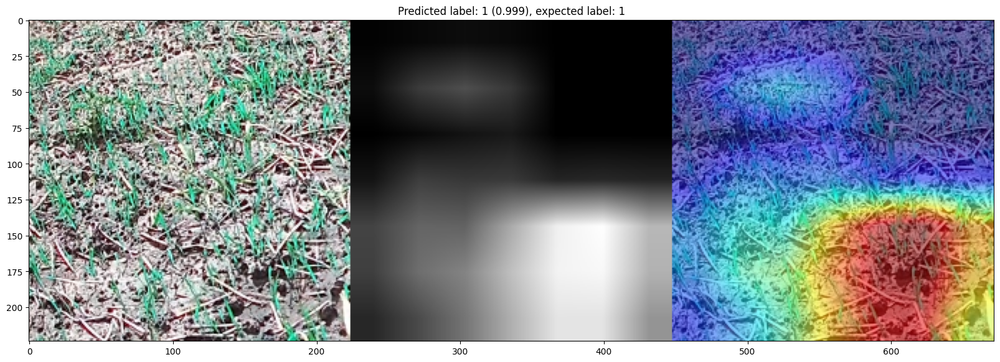

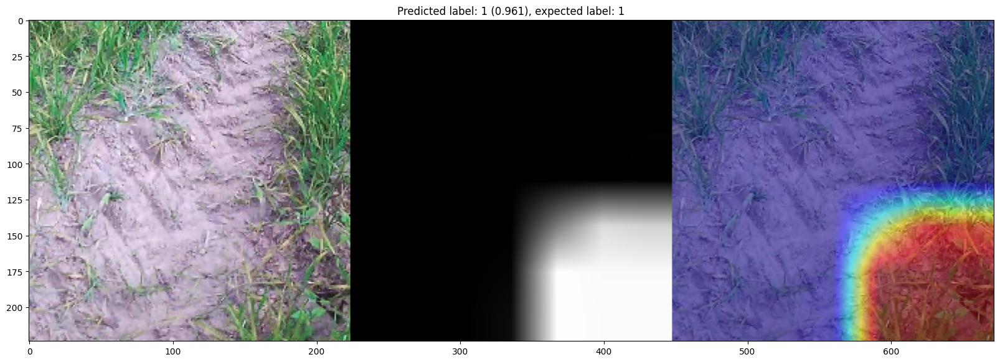

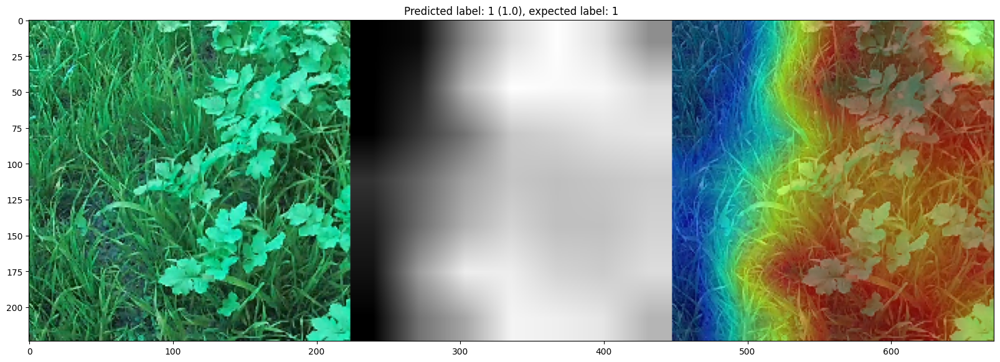

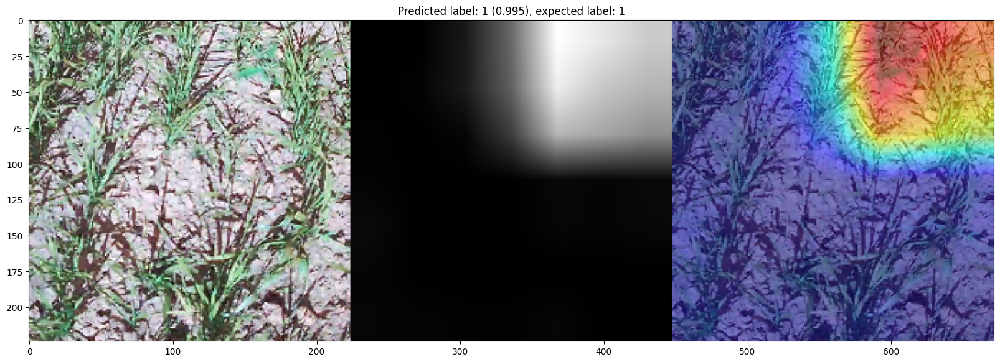

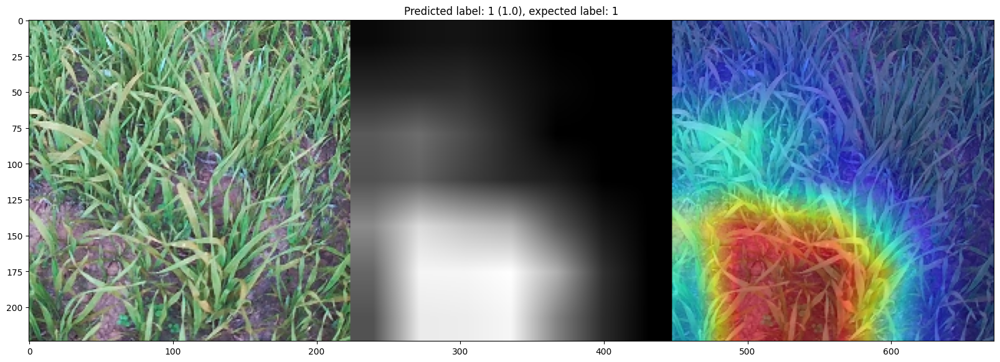

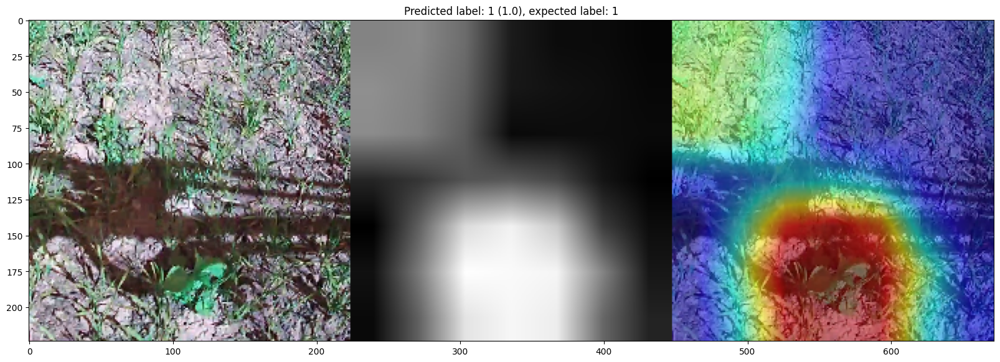

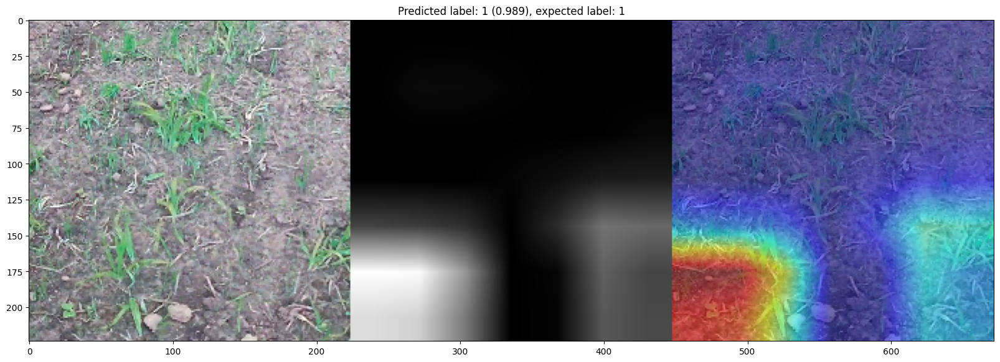

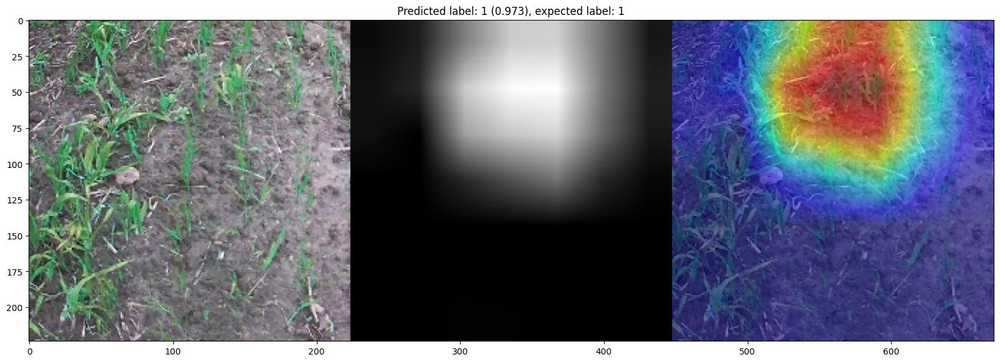

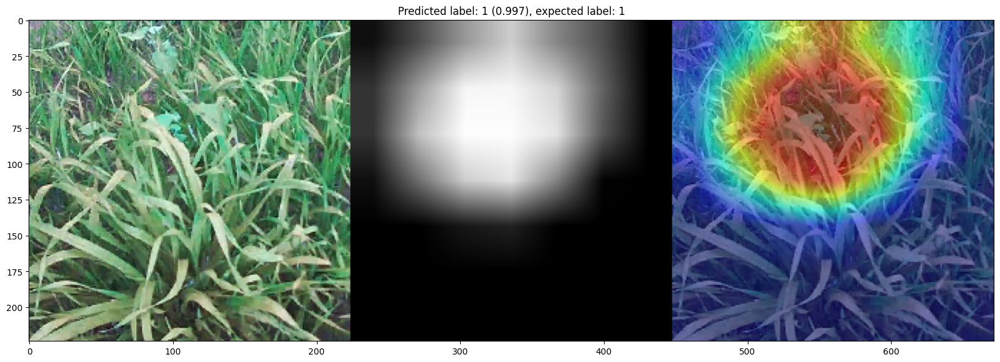

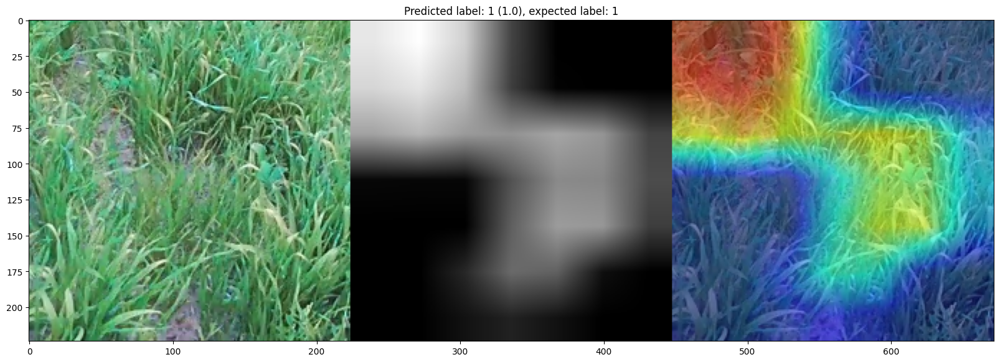

In [4]:
image_files = glob.glob('data/wheat/train_val_squares/spray/*.jpg')
i = 0
for img_file in image_files:
    ret = process(img_file, True)
    i += int(ret)
    if i == 10:
        break

# Incorrect classified dont spray (FP)

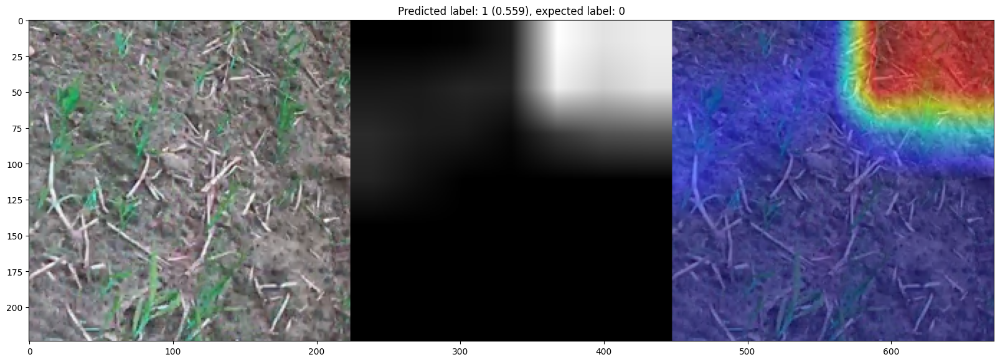

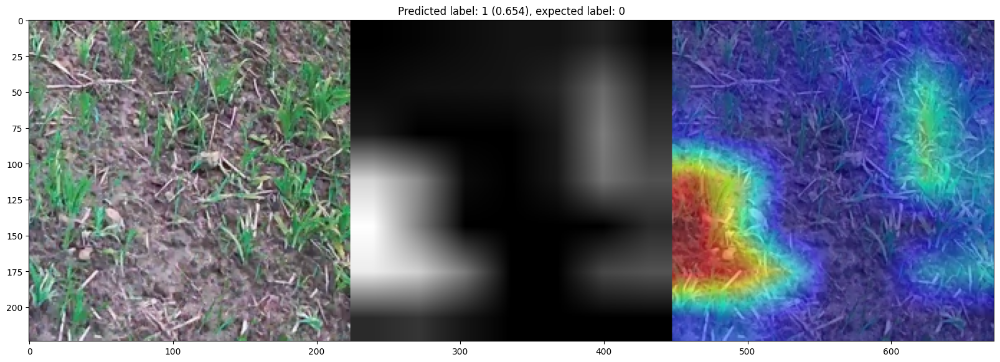

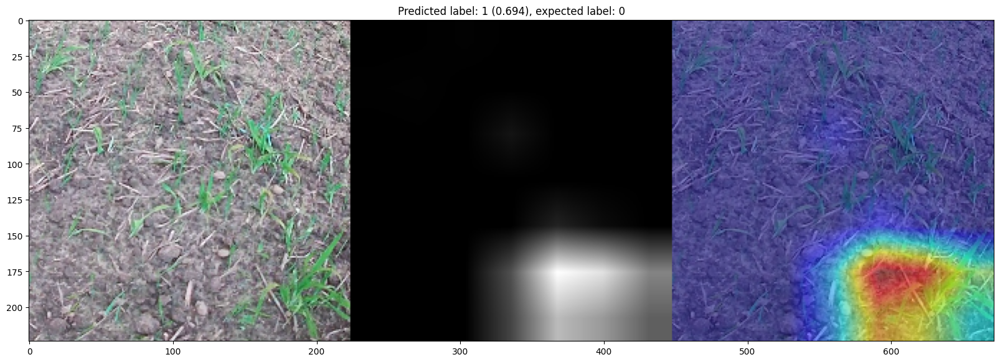

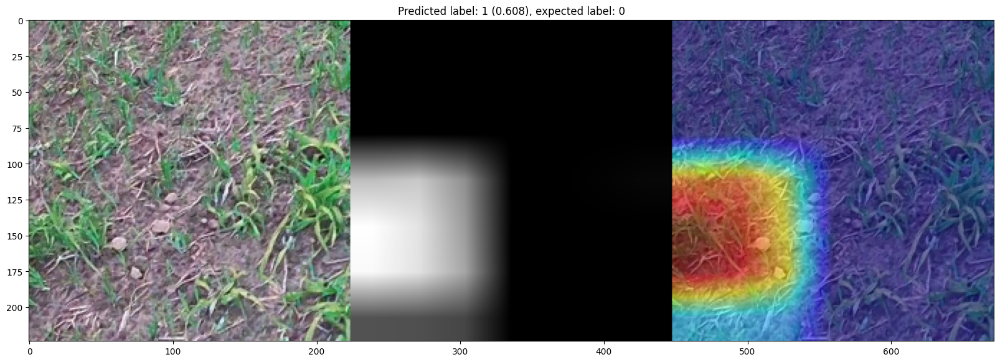

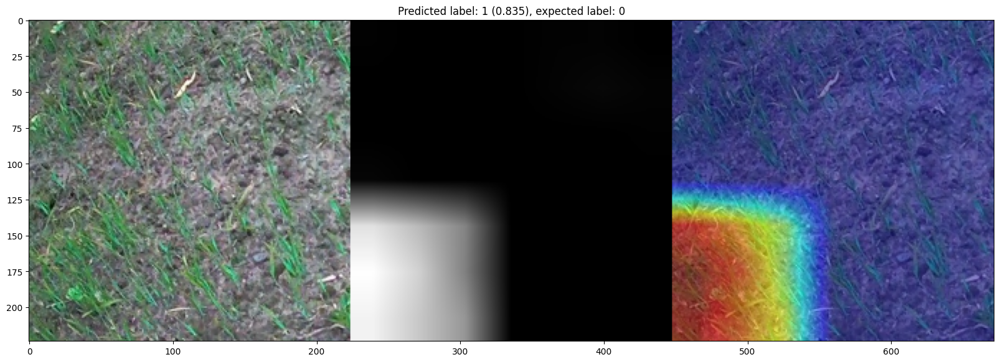

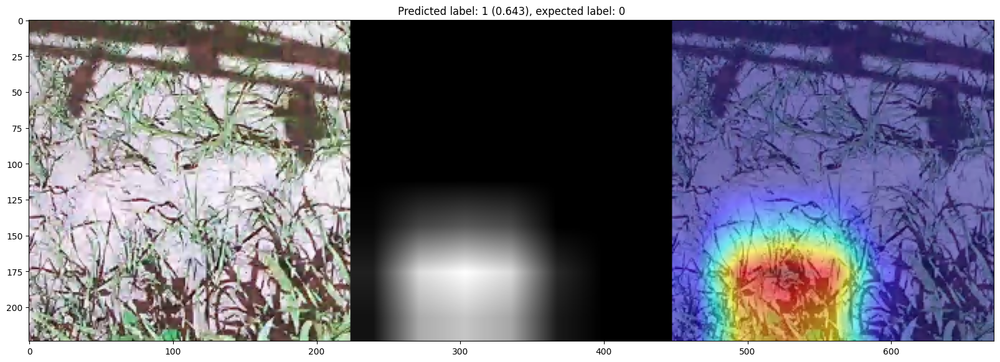

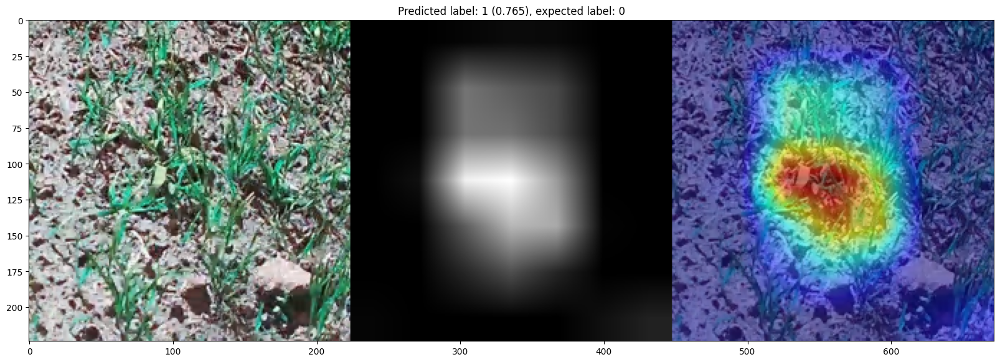

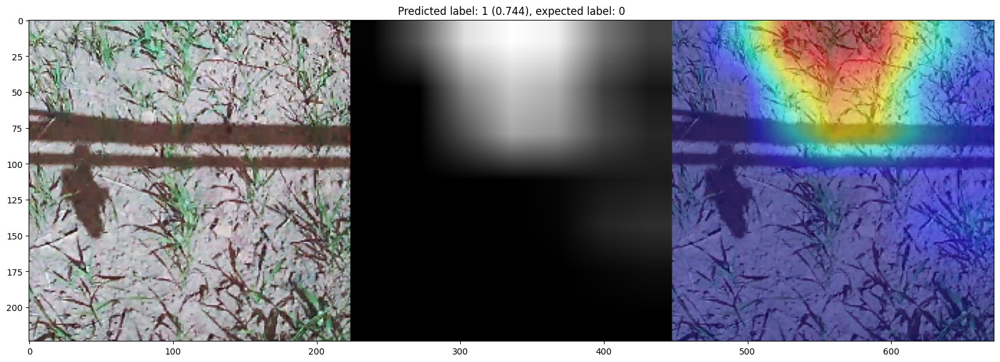

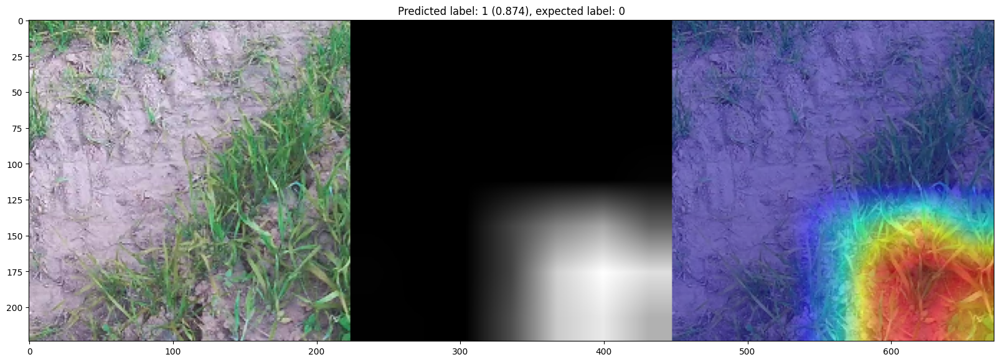

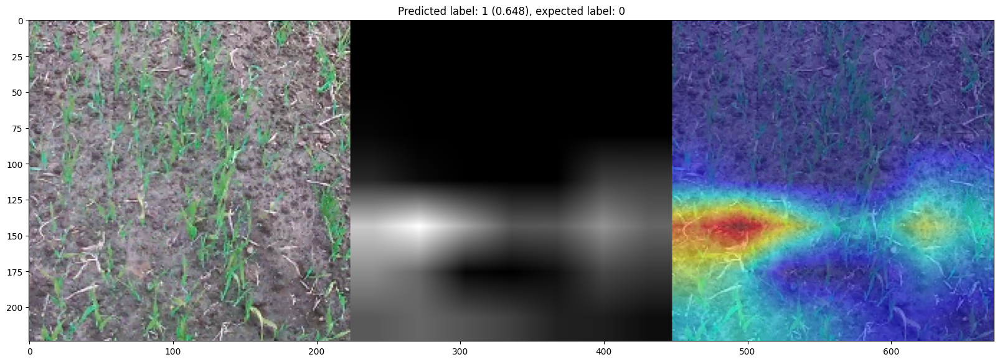

In [6]:
image_files = glob.glob('data/wheat/train_val_squares/dont/*.jpg')
i = 0
for img_file in image_files:
    ret = process(img_file, False)
    i += int(ret)
    if i == 10:
        break

# Incorrect classified spray examples (FN)

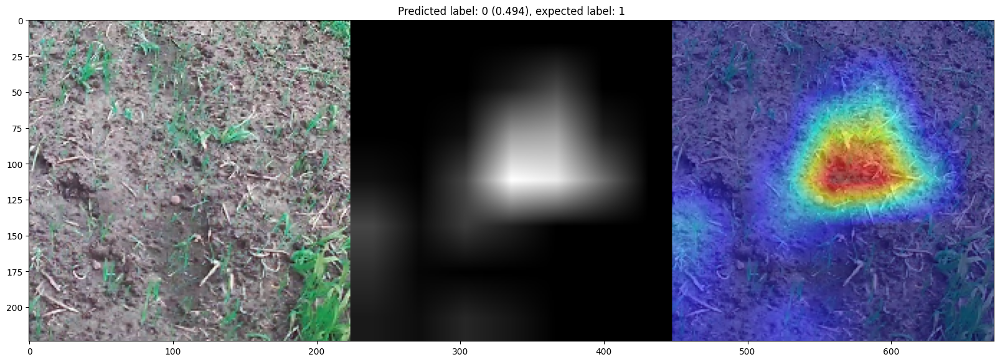

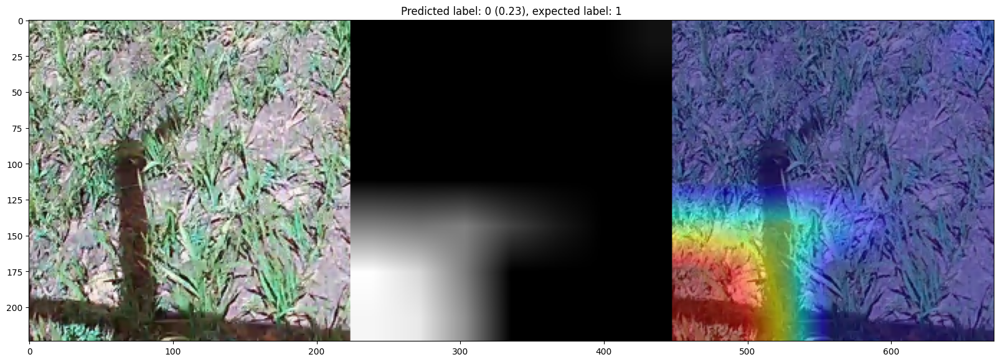

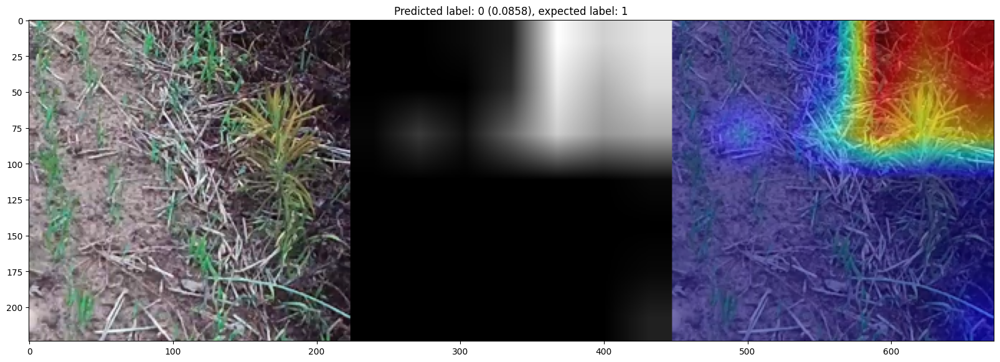

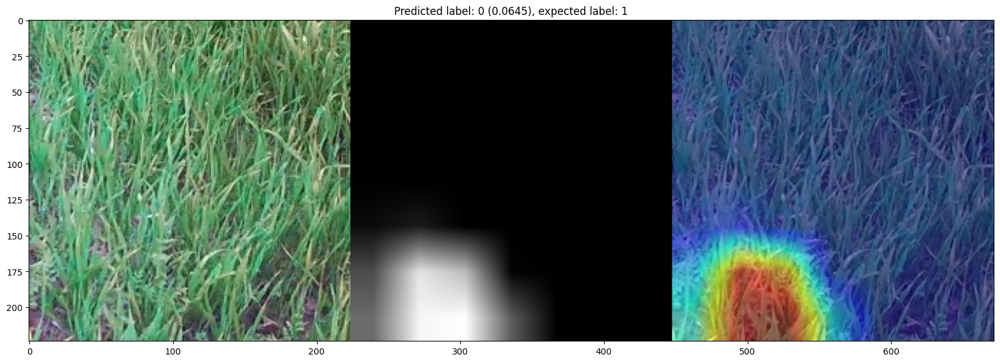

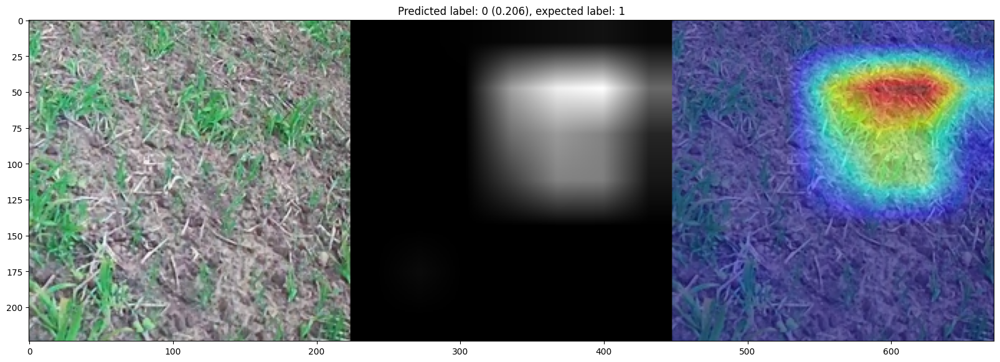

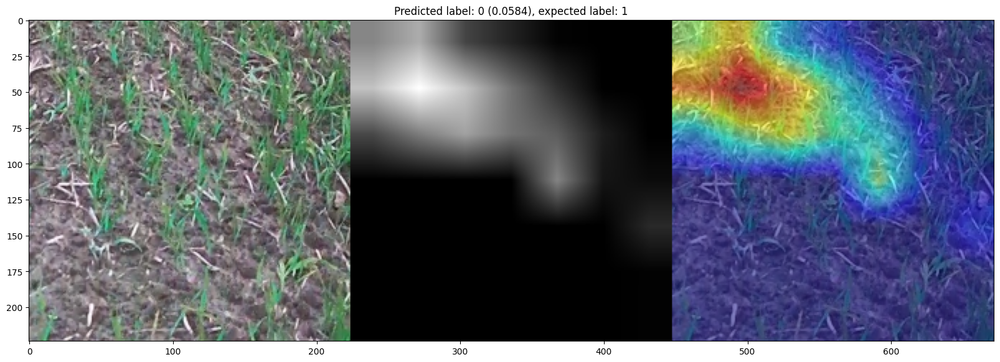

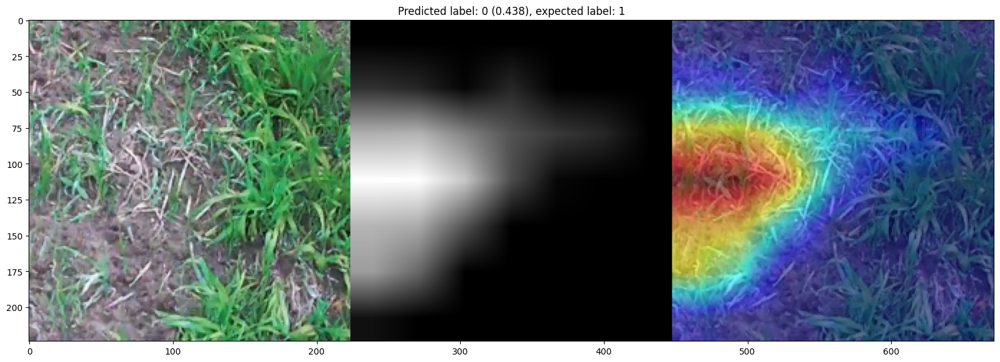

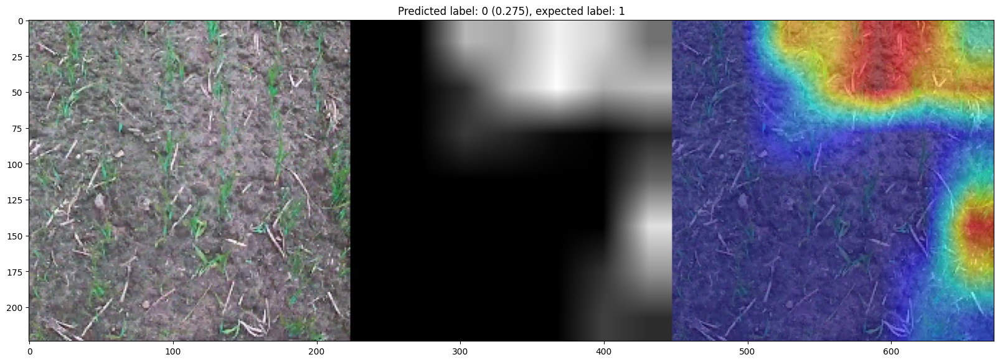

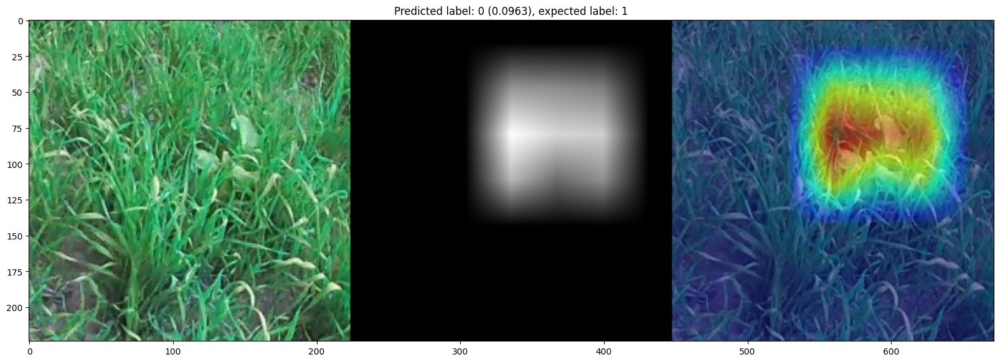

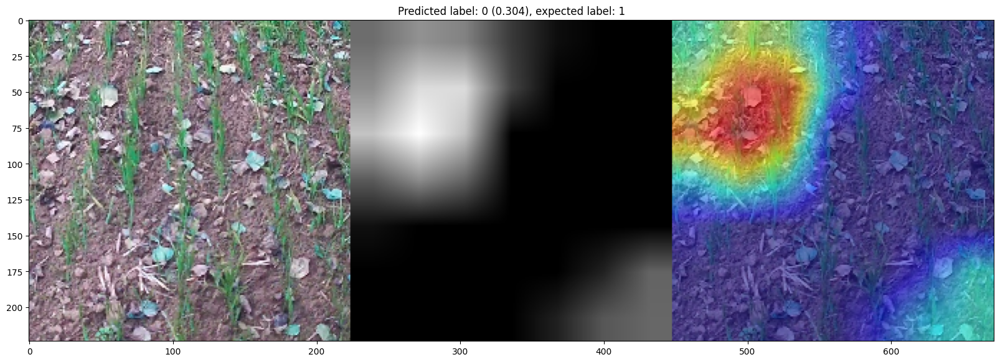

In [5]:
image_files = glob.glob('data/wheat/train_val_squares/spray/*.jpg')
i = 0
for img_file in image_files:
    ret = process(img_file, False)
    i += int(ret)
    if i == 10:
        break